### TABLE CREATION

In [2]:
import numpy as np
from sklearn.metrics import make_scorer, f1_score
from sklearn.model_selection import PredefinedSplit

from TwoStageClassifier import TwoStageClassifier
from distributionsHelper import visualize_datasets
from featureSelection import find_best_features_sets
from helper import *
from metrics_helper import plot_roc_curves, calculate_metrics
from plotter import *
from smoothingHelper import interpolate_subset_simple_labels, smooth_subset
from trainer import get_best_model, print_metrics

In [3]:
data_train = pd.read_pickle("DamasconeA25.pkl")
data_validation = pd.read_pickle("DamasconeA5.pkl")
data_test = pd.read_pickle("DamasconeB5.pkl")

# data_train = create_df("DamasconeA/data2/*_CPXE_*.csv", offset=(49, 51), angle=1)
# data_validation = create_df("DamasconeA/data1/*_CPXE_*.csv", offset=(49, 50), angle=-1)
# data_test = create_df("DamasconeB/together/*_CPXE_*.csv", symmetric=True)
#
# data_validation.to_pickle("DamasconeA5.pkl")
# data_test.to_pickle("DamasconeB5.pkl")
# data_train.to_pickle("DamasconeA25.pkl")

### Signal plot

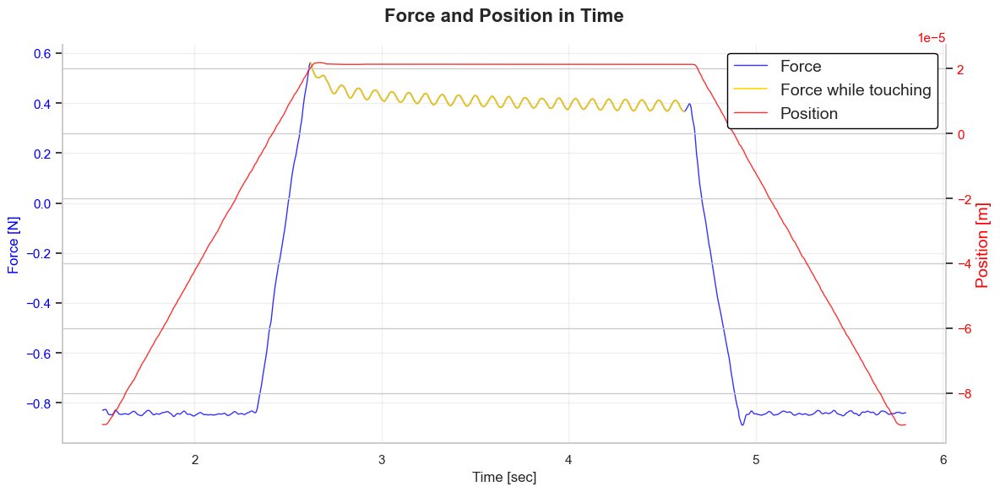

In [13]:
fig = plot_force_position(data_train)
# fig.savefig('signal.png')

In [5]:
feature_list = ['Stiffness', 'Tau', 'Entropy', 'Upstroke', 'Downstroke', 'P_ss',
                'force_overshoot', 'force_relaxation', 'force_rms',
                'damping_coefficient', 'contact_area', 'force_ptp', 'activity',
                'mobility', 'tkeo_mean', 'correlation_fp', 'peak_ratio', 'sample_entropy',
                'loading_skewness', 'loading_kurtosis', 'quartic_coefficient']

### NaN Handling and Spatial Smoothing

In [6]:
print(len(data_validation), len(data_test), len(data_train))

nan_counts = data_validation.isna().sum()
nan_counts = nan_counts[nan_counts > 0]
print(nan_counts)

nan_counts = data_test.isna().sum()
nan_counts = nan_counts[nan_counts > 0]
print(nan_counts)

nan_counts = data_train.isna().sum()
nan_counts = nan_counts[nan_counts > 0]
print(nan_counts)

# Fill missing points inside the grid, and single feature values that are NaN
data_test = interpolate_subset_simple_labels(data_test, feature_list)
data_train = interpolate_subset_simple_labels(data_train, feature_list)
data_validation = interpolate_subset_simple_labels(data_validation, feature_list)

print(len(data_validation), len(data_test), len(data_train))

6560 6557 6559
contact_area    2
dtype: int64
contact_area    2
dtype: int64
Upstroke    1
dtype: int64
6561 6561 6561


In [7]:
smoothing_config = {feature: 'median' for feature in feature_list}

# Smooth each subset SEPARATELY
smoothed_test = smooth_subset(data_test, feature_list, smoothing_config)
smoothed_train = smooth_subset(data_train, feature_list, smoothing_config)
smoothed_validation = smooth_subset(data_validation, feature_list, smoothing_config)

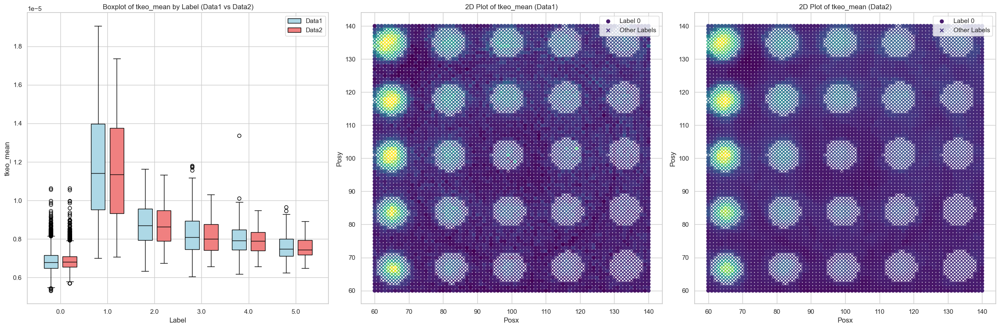

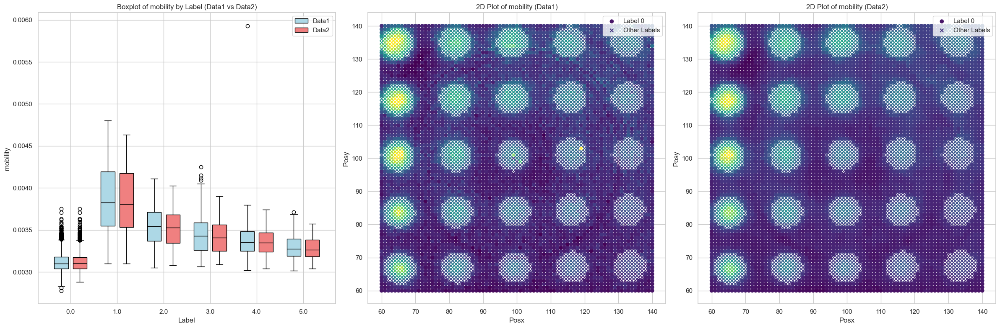

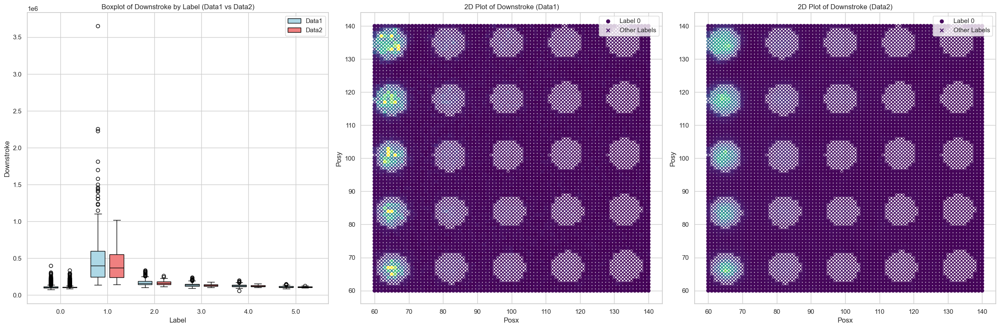

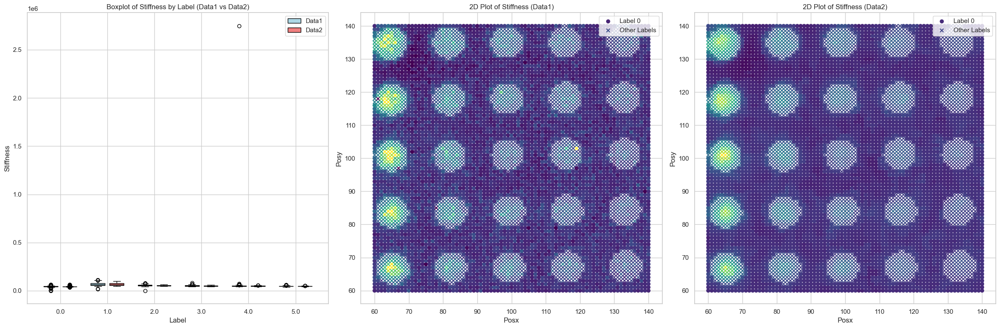

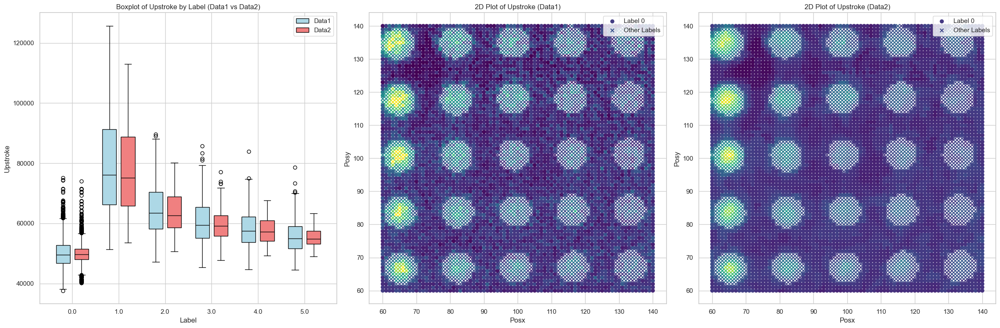

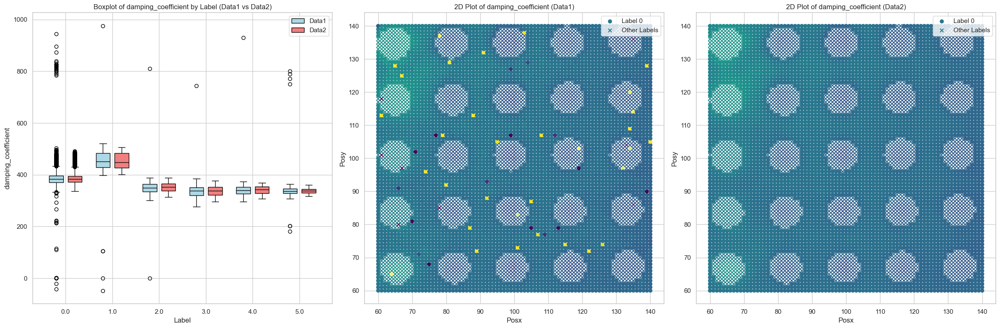

In [8]:
# Plot selected features
features_to_show = ['tkeo_mean',
                    'mobility',
                    'Downstroke',
                    'Stiffness',
                    'Upstroke',
                    'damping_coefficient']  # just important features used during final training, in order to get lighter output

plot_features(data_train, smoothed_train, features_to_show)

### Dataset Splitting


Class distribution in Training set:
Label 0.0: 4609 samples (70.25%)
Label 1.0: 395 samples (6.02%)
Label 2.0: 391 samples (5.96%)
Label 3.0: 379 samples (5.78%)
Label 4.0: 391 samples (5.96%)
Label 5.0: 396 samples (6.04%)

Class distribution in Test set:
Label 0.0: 4616 samples (70.36%)
Label 1.0: 388 samples (5.91%)
Label 2.0: 388 samples (5.91%)
Label 3.0: 393 samples (5.99%)
Label 4.0: 388 samples (5.91%)
Label 5.0: 388 samples (5.91%)

Class distribution in Validation set:
Label 0.0: 4607 samples (70.22%)
Label 1.0: 390 samples (5.94%)
Label 2.0: 395 samples (6.02%)
Label 3.0: 383 samples (5.84%)
Label 4.0: 395 samples (6.02%)
Label 5.0: 391 samples (5.96%)


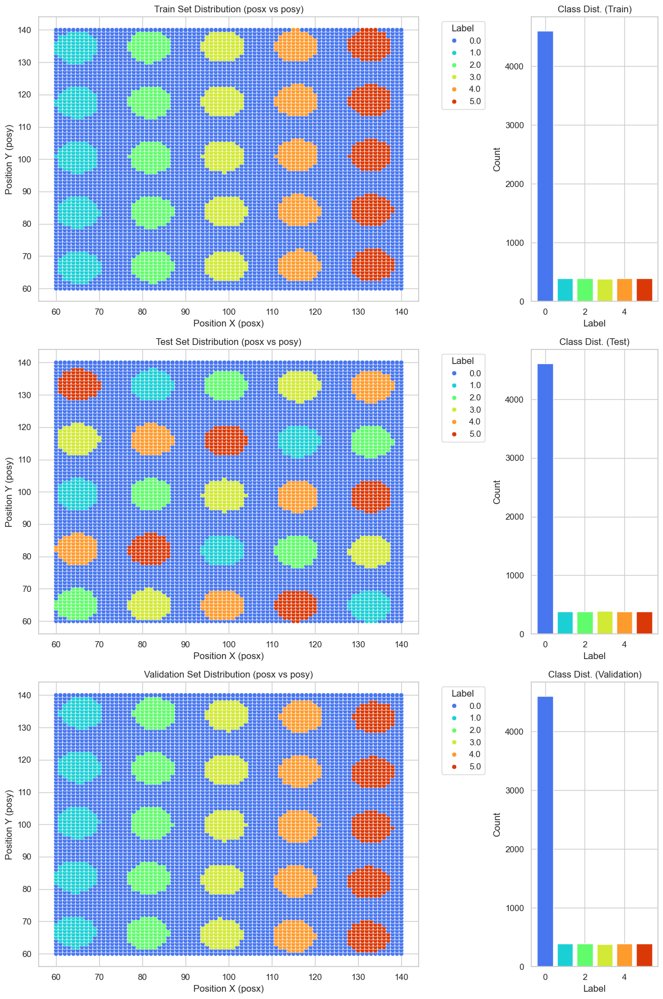

In [7]:
visualize_datasets(smoothed_train, data_test, smoothed_validation, label_column='label')

In [9]:
# Create X and y dataset with posx, posy
X_train, y_train = prepare_xy(smoothed_train, feature_list)
X_test, y_test = prepare_xy(smoothed_test, feature_list)
X_validation, y_validation = prepare_xy(smoothed_validation, feature_list)

In [10]:
# Scale dataset with posx, posy
X_train_scaled = scale_dataset(X_train, feature_list)
X_validation_scaled = scale_dataset(X_validation, feature_list)
X_test_scaled = scale_dataset(X_test, feature_list)

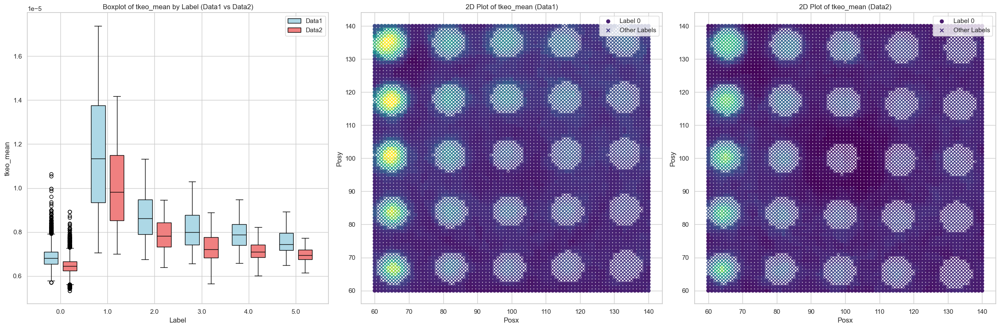

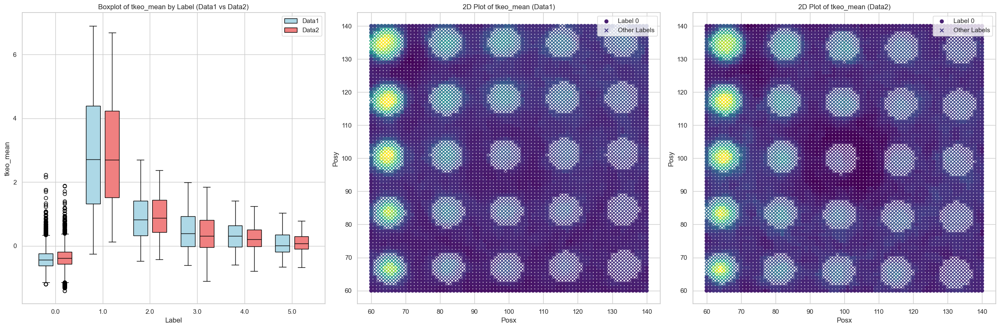

In [10]:
# Visualization of the scaling effect on train and validation for a single feature
plot_features(pd.concat([X_train, y_train], axis=1), pd.concat([X_validation, y_validation], axis=1),
              ["tkeo_mean"])

plot_features(pd.concat([X_train_scaled, y_train], axis=1), pd.concat([X_validation_scaled, y_validation], axis=1),
              ["tkeo_mean"])

In [11]:
# Find points with y != 0 (not background)
hard_spots_train, y_train_hard = get_hard_spots(X_train_scaled, y_train)
hard_spots_validation, y_validation_hard = get_hard_spots(X_validation_scaled, y_validation)

# Feature Selection

In [12]:
# Global feature selection parameters
MIN_MI = 0.3
MAX_W_DIST = 0.15
MAX_W_DIST_CLASS = 0.2
STEP = 0.025

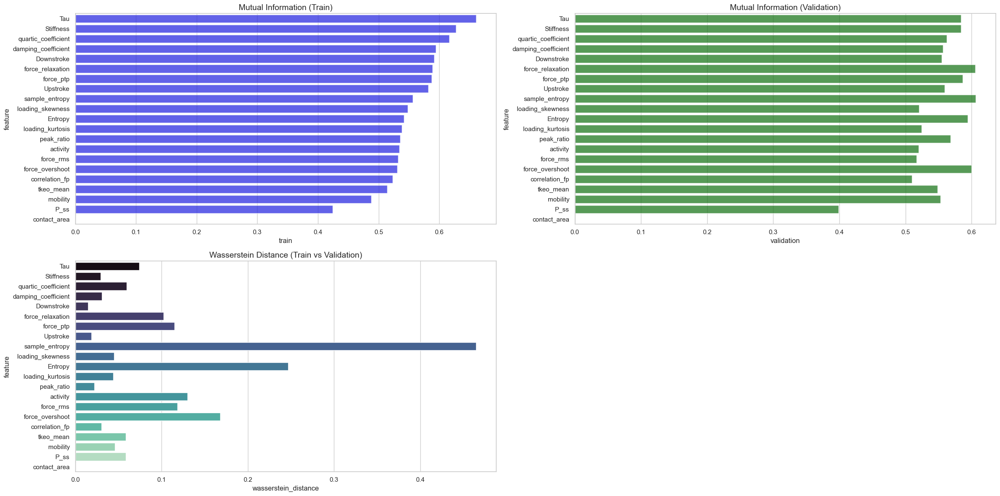

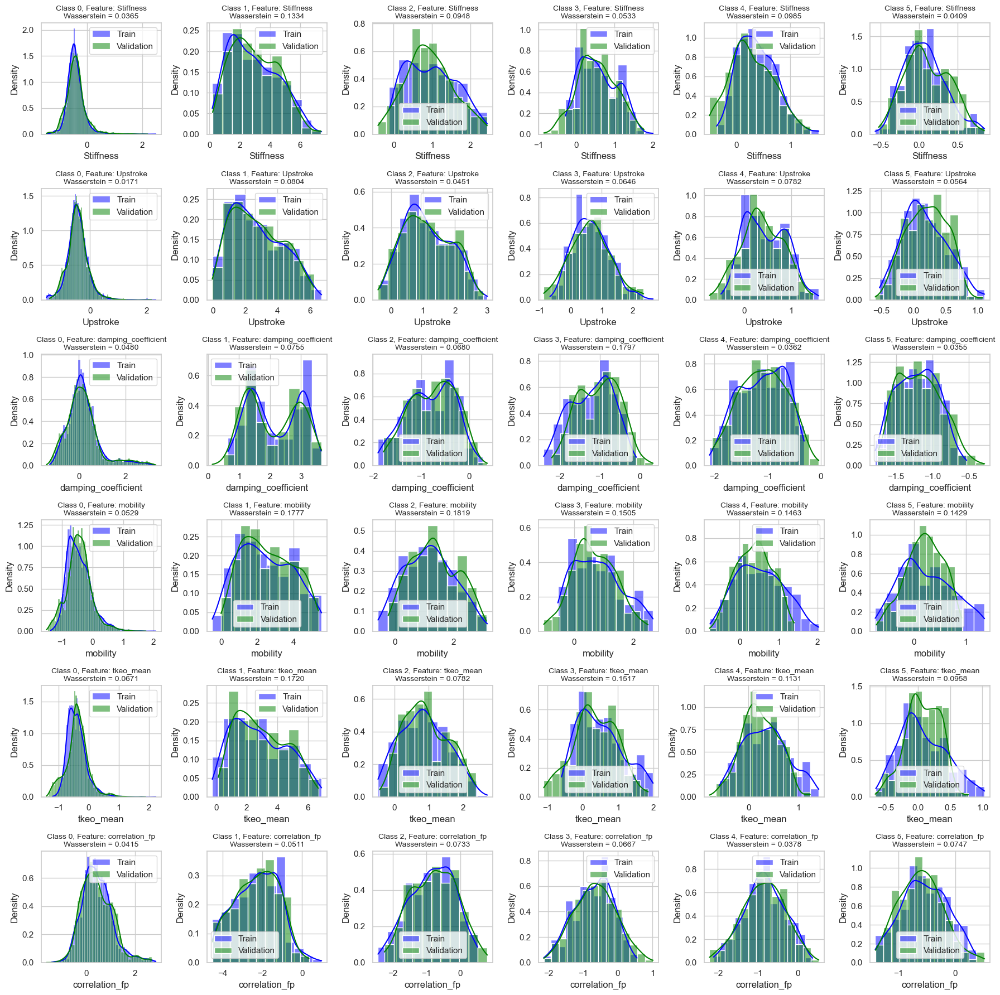

In [13]:
from featureSelection import find_best_features

selected_features = find_best_features(
    X_train_scaled=X_train_scaled,
    y_train=y_train,
    X_validation_scaled=X_validation_scaled,
    y_validation=y_validation,
    feature_list=feature_list,
    selected_classes=[0, 1, 2, 3, 4, 5],
    mi_threshold=MIN_MI,
    wasserstein_threshold=MAX_W_DIST,
    class_wasserstein_threshold=MAX_W_DIST_CLASS,
    plot=True
)

In [14]:
wasserstein_thresholds = np.arange(STEP, MAX_W_DIST + STEP, STEP).tolist()  # [STEP, MAX_W_DIST] with step STEP
wasserstein_thresholds_per_class = np.arange(STEP, MAX_W_DIST_CLASS + STEP,
                                             STEP).tolist()  # [STEP, MAX_W_DIST_CLASS] with step STEP

features_df = find_best_features_sets(
    X_train=X_train_scaled,
    y_train=y_train,
    X_validation=X_validation_scaled,
    y_validation=y_validation,
    features_to_smooth=feature_list,
    mi_th=MIN_MI,
    wasserstein_th=wasserstein_thresholds,
    wasserstein_th_per_class=wasserstein_thresholds_per_class,
    classes_to_check=[2, 3, 4, 5]
)

features_df

bandwidth: 100%|██████████| 6/6 [01:42<00:00, 17.07s/it]


,w_th,w_th_c,n_features,features,silhouette
0,0.050,0.100,3,"[Stiffness, Upstroke, Downstroke]",0.212622
1,0.075,0.175,4,"[Stiffness, Upstroke, Downstroke, tkeo_mean]",0.197751
2,0.100,0.200,6,"[Stiffness, Upstroke, Downstroke, damping_coef...",0.241002


In [15]:
all_selected_features = list(set().union(*features_df['features']))
all_selected_features

['damping_coefficient',
 'Stiffness',
 'Upstroke',
 'Downstroke',
 'tkeo_mean',
 'mobility']

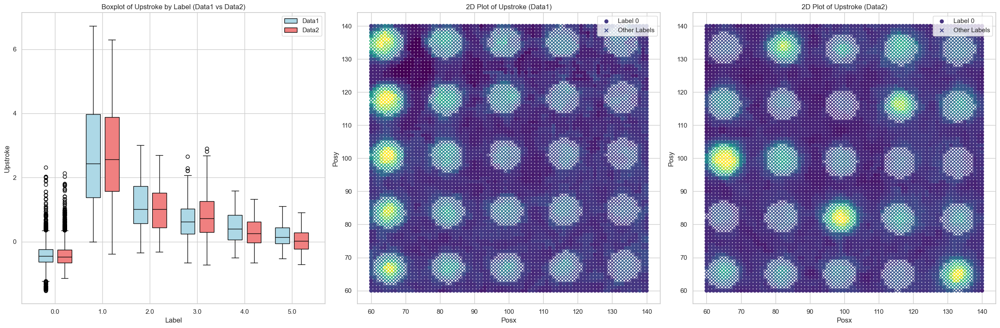

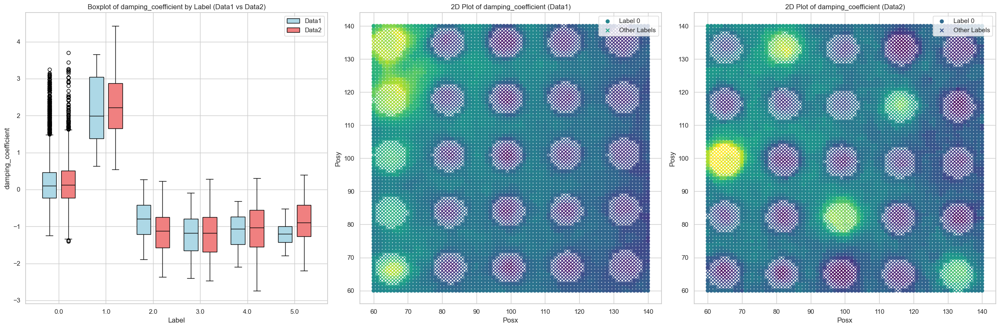

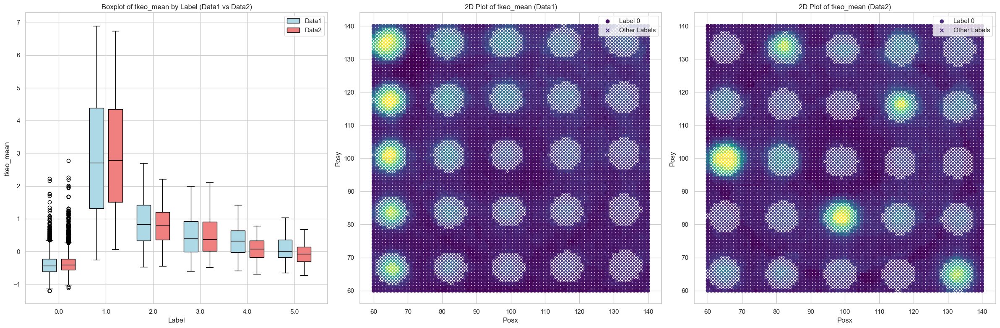

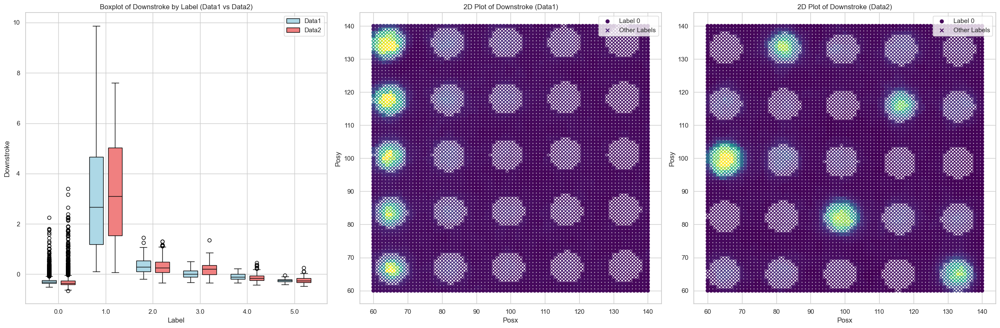

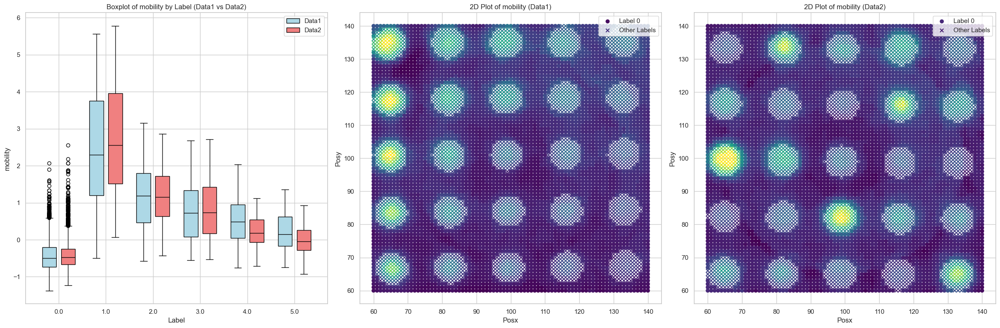

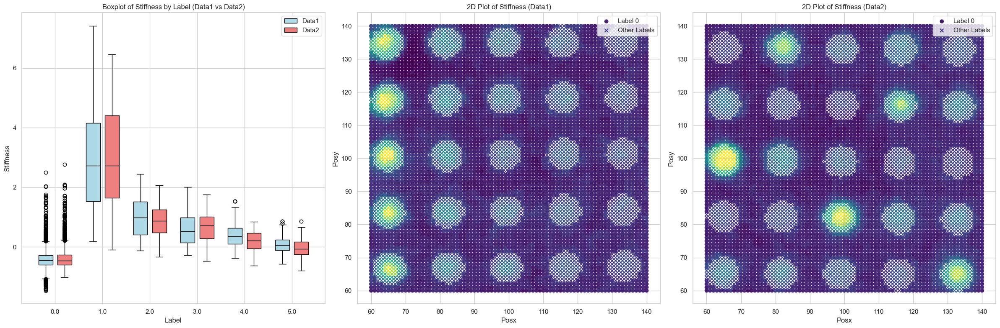

In [30]:
# Plot selected features
plot_features(pd.concat([X_train_scaled, y_train], axis=1), pd.concat([X_test_scaled, y_test], axis=1),
              all_selected_features)

### Max spatial smoothing

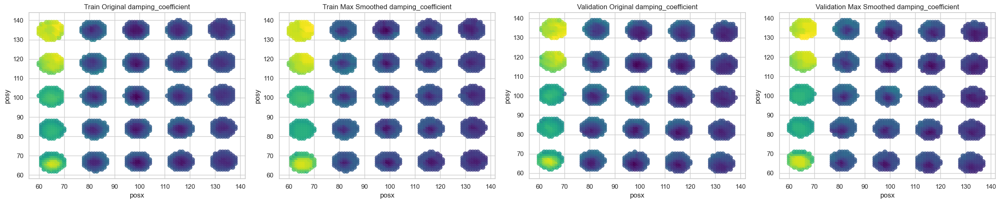

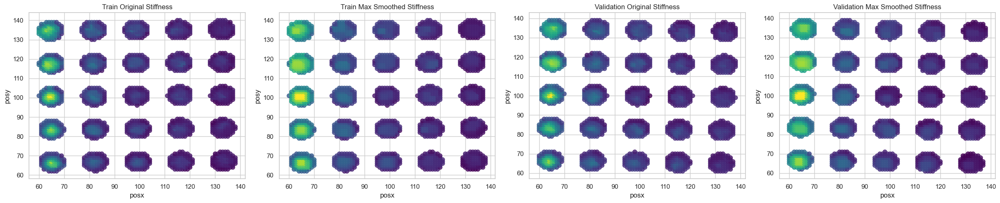

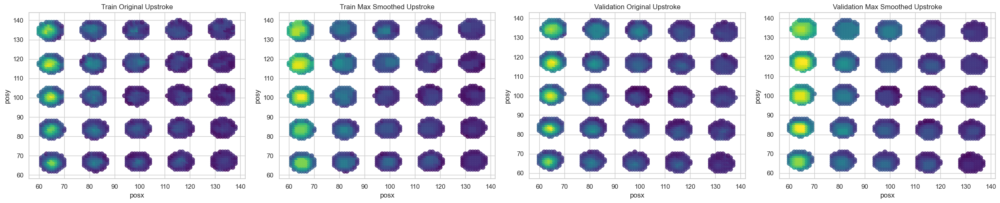

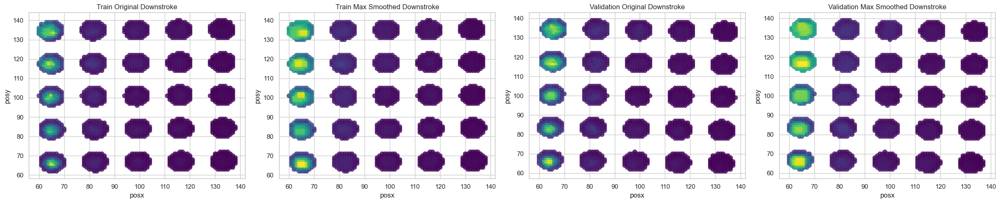

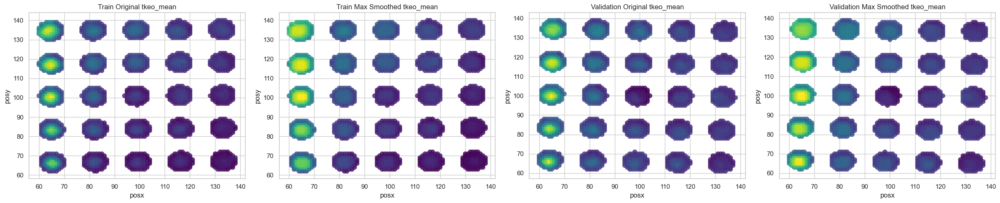

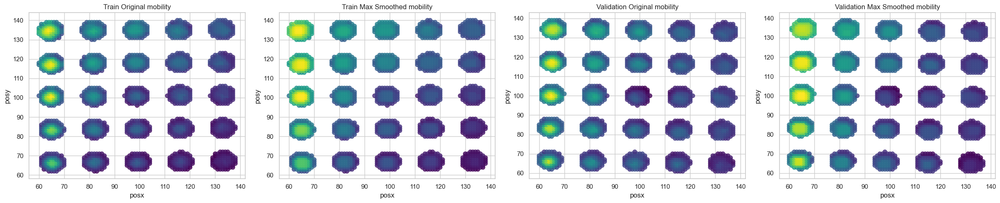

In [16]:
from smoothingHelper import grid_max_smooth

# Apply 3x3 max smoothing to train set
hard_spots_train_smoothed = grid_max_smooth(
    hard_spots_train,
    all_selected_features,
    grid_range=1
)

# Apply 3x3 max smoothing to validation set
hard_spots_validation_smoothed = grid_max_smooth(
    hard_spots_validation,
    all_selected_features,
    grid_range=1
)

# # Visualize the smoothing effect for each feature
for feature in all_selected_features:
    plot_smoothing_effect(
        hard_spots_validation,
        hard_spots_validation_smoothed,
        hard_spots_train,
        hard_spots_train_smoothed,
        feature
    )

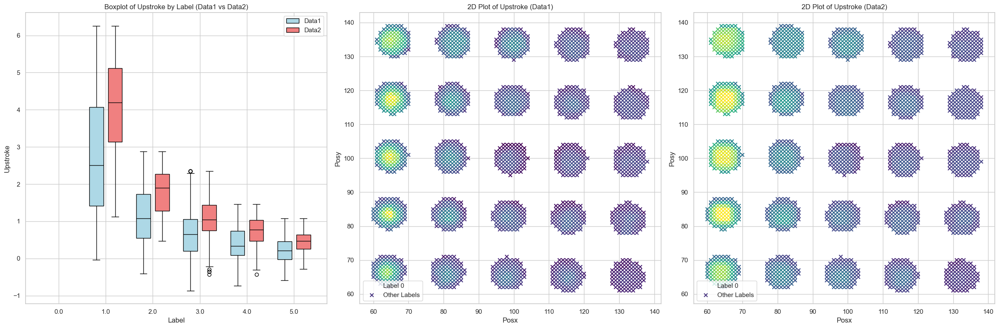

In [36]:
plot_features(pd.concat([hard_spots_validation, y_validation], axis=1),
              pd.concat([hard_spots_validation_smoothed, y_validation], axis=1),
              ['Upstroke'])

# Models Definitions

In [17]:
from xgboost import XGBClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier

# List of model hyperparameters definitions
models = [
    # 1. Support Vector Classifier
    {
        'model': SVC(kernel='rbf', probability=True),
        'hyperparameters': {
            # Lower C means stronger regularization
            'C': [0.01, 0.1, 1, 10],
            'gamma': ['scale', 'auto', 0.001, 0.01, 0.1]  # Avoid very large gamma (e.g., 0.5 or higher)
        }
    },

    # 2. Random Forest Classifier
    {
        'model': RandomForestClassifier(
            n_jobs=-1, bootstrap=True, criterion='entropy',
            max_features=0.3,  # Reduce max_features to control complexity
            n_estimators=300
        ),
        'hyperparameters': {
            'max_depth': [6, 8, 10],  # Avoid very deep trees
            'min_samples_split': [5, 10, 15],  # More conservative splits
            'min_samples_leaf': [4, 8, 12]  # Prevent overly specific splits
        }
    },

    # 3. Logistic Regression
    {
        'model': LogisticRegression(max_iter=500, solver='saga'),
        'hyperparameters': {
            'C': [0.001, 0.01, 0.1, 1.0],  # Stronger regularization
            'penalty': ['l1', 'l2'],
        }
    },

    # 4. XGBoost Classifier
    {
        'model': XGBClassifier(use_label_encoder=False, eval_metric='mlogloss'),
        'hyperparameters': {
            'n_estimators': [200, 300],
            'learning_rate': [0.01, 0.05, 0.1],  # Avoid very aggressive learning
            'max_depth': [3, 5, 6],  # Shallow trees generalize better
            'gamma': [0, 0.1, 0.5, 1],  # Control overfitting by penalizing splits
            'subsample': [0.6, 0.8],  # Encourage randomness
            'colsample_bytree': [0.6, 0.8],
            'min_child_weight': [3, 5, 7]  # Require more data per leaf
        }
    }
]

# Generate the combinations
param_grid = generate_combinations(features_df, models)

# Models training

In [17]:
X_train_val = pd.concat([X_train_scaled, X_validation_scaled], axis=0)
y_train_val = pd.concat([y_train, y_validation], axis=0)

test_fold = [0] * len(X_train_scaled) + [1] * len(X_validation_scaled)
X_train_val['fold'] = test_fold

In [20]:
from sklearn.model_selection import RandomizedSearchCV

clf = TwoStageClassifier(train_smoothed=[hard_spots_train_smoothed, hard_spots_validation_smoothed])
ps = PredefinedSplit(test_fold)

random_search = RandomizedSearchCV(
    clf,
    param_grid,
    n_iter=55000,
    scoring=make_scorer(f1_score, average='macro'),
    error_score='raise',  # stop immediately after an exception (e.g. TwoStageClassifier is badly implemented)
    cv=ps,
    n_jobs=-1,
    refit=False,  # do not retrain on whole dataset after finding the best parameters (manually done later)
    verbose=1
)

random_search.fit(X_train_val, y_train_val)
print("Best Params:", random_search.best_params_)
print("Best Score:", random_search.best_score_)

Fitting 2 folds for each of 55000 candidates, totalling 110000 fits


D:\Anaconda\envs\DMML\Lib\site-packages\numpy\ma\core.py:2892: RuntimeWarning: invalid value encountered in cast
  _data = np.array(data, dtype=dtype, copy=copy,


Best Params: {'multiclass_classifier__gamma': 'scale', 'multiclass_classifier__C': 10, 'multiclass_classifier': SVC(probability=True), 'features': ['Stiffness', 'Upstroke', 'Downstroke', 'damping_coefficient', 'mobility', 'tkeo_mean'], 'binary_classifier__subsample': 0.6, 'binary_classifier__n_estimators': 200, 'binary_classifier__min_child_weight': 3, 'binary_classifier__max_depth': 3, 'binary_classifier__learning_rate': 0.05, 'binary_classifier__gamma': 0.1, 'binary_classifier__colsample_bytree': 0.6, 'binary_classifier': XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric='mlogloss',
              feature_types=None, gamma=None, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=None, max_bin=None, max_cat_threshold=None,
    

### Train the model with Train and Validation Datasets

D:\Anaconda\envs\DMML\Lib\site-packages\xgboost\core.py:158: UserWarning: [18:39:14] WARNING: C:\b\abs_90_bwj_86a\croot\xgboost-split_1724073762025\work\src\learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)



=== Test Metrics ===
Accuracy:  0.8383
F1 Score (macro):  0.6438


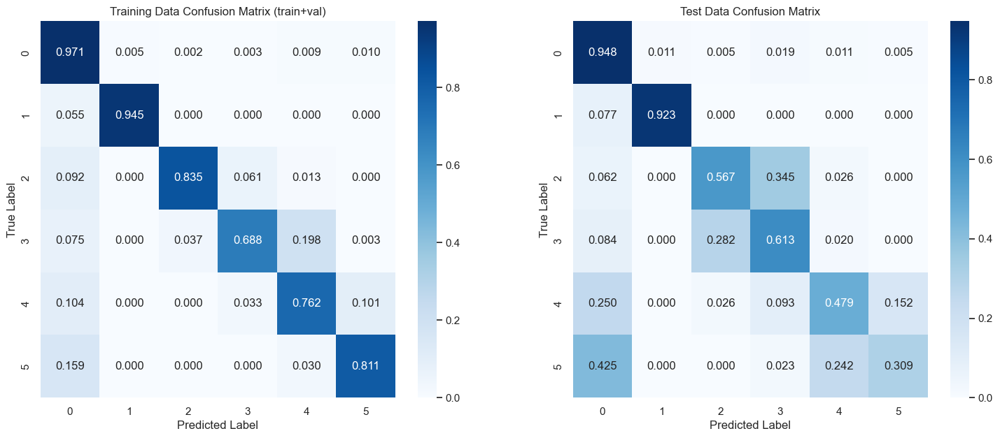

In [19]:
# train with everything
#best_clf, best_features = get_best_model(random_search, hard_spots_train_smoothed, hard_spots_validation_smoothed)

X_train_val['fold'] = [2] * len(X_train_val)  # 2 -> both validation and train stacked

# Now fit and evaluate as before
best_clf.fit(X_train_val[best_features + ['fold']], y_train_val)

# Make predictions
y_pred_test = best_clf.predict(X_test_scaled[best_features])
y_pred_train = best_clf.predict(X_train_val[best_features])

# Plot confusion matrices
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 7))
plot_confusion_matrix(y_train_val, y_pred_train, 'Training Data Confusion Matrix (train+val)', ax1)
plot_confusion_matrix(y_test, y_pred_test, 'Test Data Confusion Matrix', ax2)

# Print performance metrics
print_metrics(y_test, y_pred_test, label="Test")

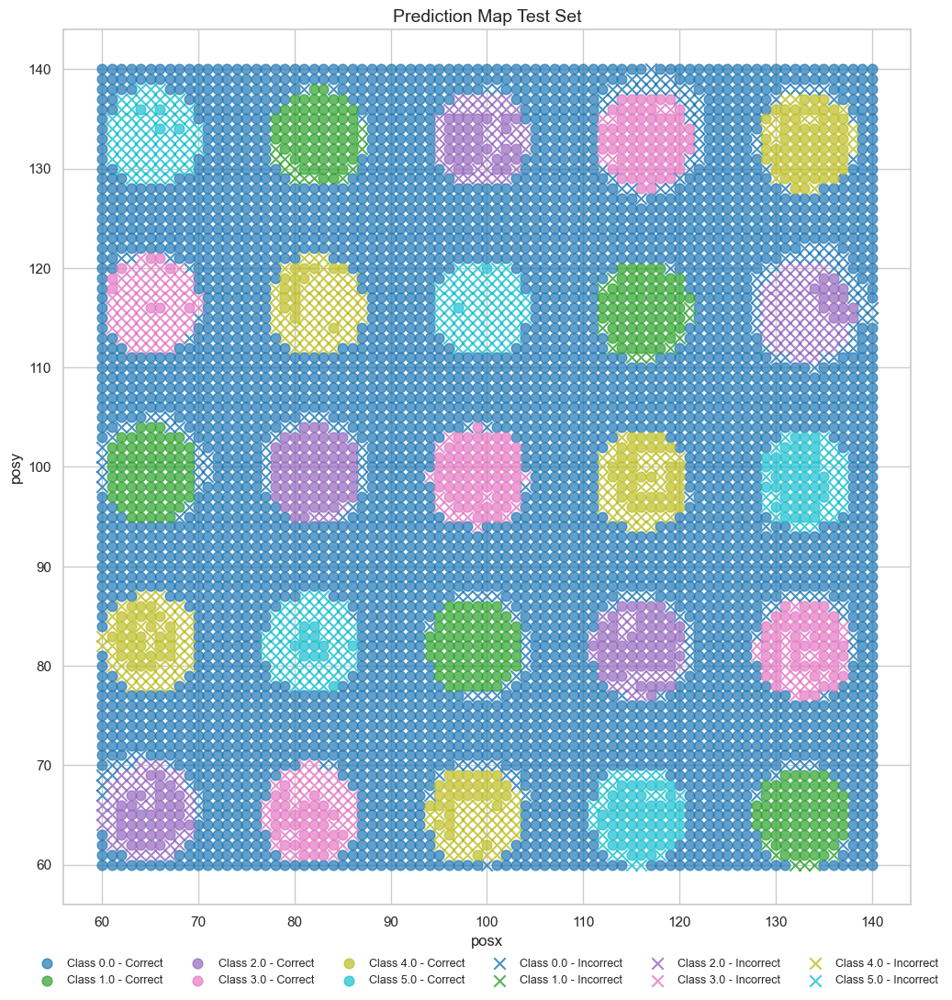

In [102]:
plot_prediction_map(X_test_scaled, y_test, y_pred_test, 'Prediction Map Test Set')

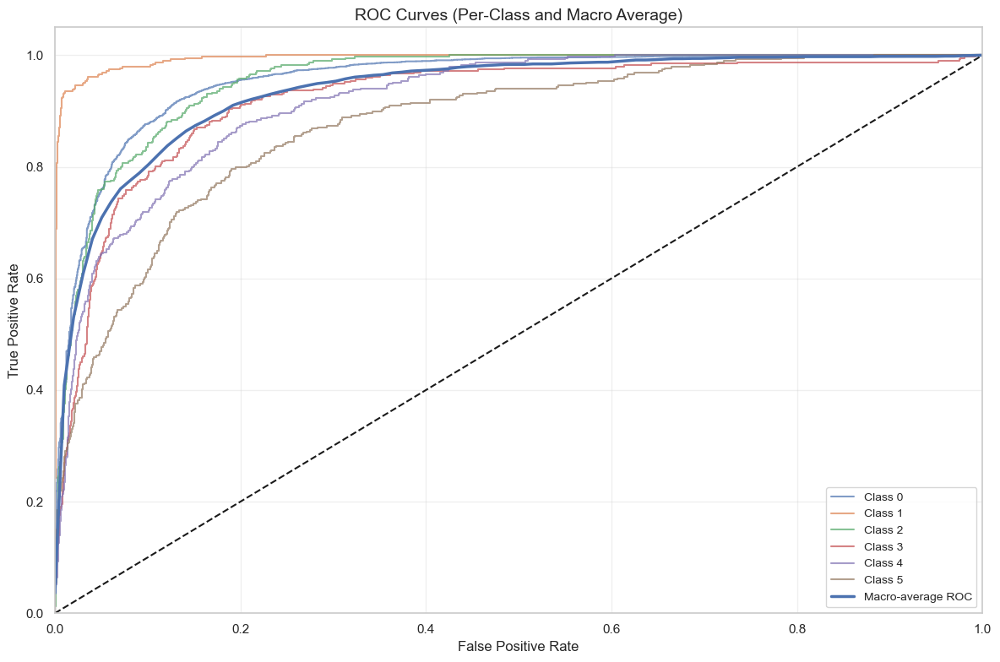

{'precision_macro': np.float64(0.6663454447433028), 'recall_macro': np.float64(0.6398953937090252), 'f1_macro': np.float64(0.6437637981600548), 'precision_class_0.0': np.float64(0.9261219305673158), 'recall_class_0.0': np.float64(0.9477902946273831), 'f1_class_0.0': np.float64(0.936830835117773), 'precision_class_1.0': np.float64(0.8710462287104623), 'recall_class_1.0': np.float64(0.9226804123711341), 'f1_class_1.0': np.float64(0.8961201501877347), 'precision_class_2.0': np.float64(0.6027397260273972), 'recall_class_2.0': np.float64(0.5670103092783505), 'f1_class_2.0': np.float64(0.5843293492695883), 'precision_class_3.0': np.float64(0.4725490196078431), 'recall_class_3.0': np.float64(0.6132315521628499), 'f1_class_3.0': np.float64(0.5337763012181617), 'precision_class_4.0': np.float64(0.5344827586206896), 'recall_class_4.0': np.float64(0.4793814432989691), 'f1_class_4.0': np.float64(0.5054347826086957), 'precision_class_5.0': np.float64(0.5911330049261084), 'recall_class_5.0': np.floa

In [25]:
y_proba = best_clf.predict_proba(X_test_scaled[best_features])

plot_roc_curves(y_test, y_proba, [0, 1, 2, 3, 4, 5])

print(calculate_metrics(y_test, y_pred_test, y_proba))

### Considerations on AUC values

#### TEST

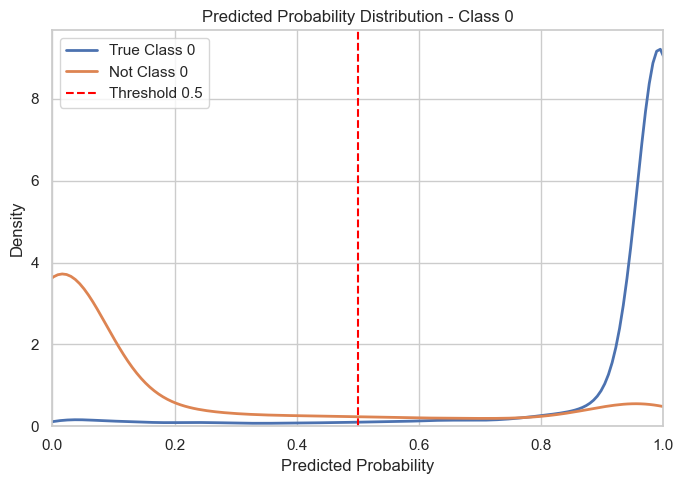

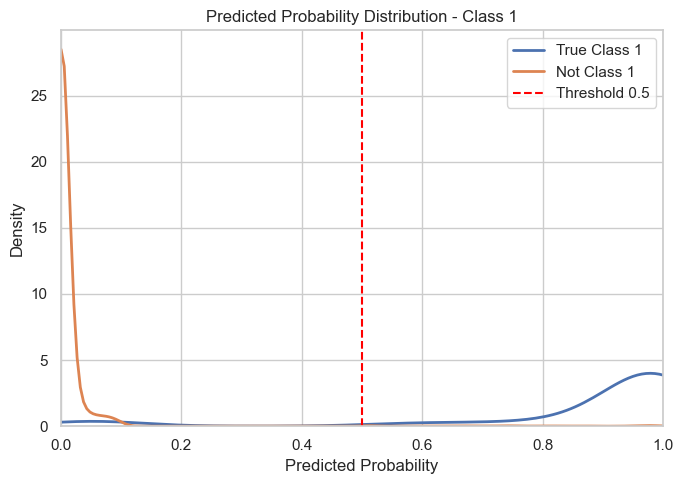

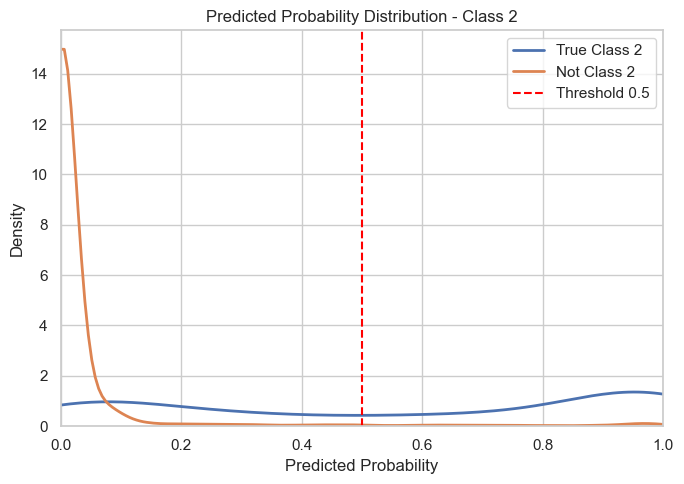

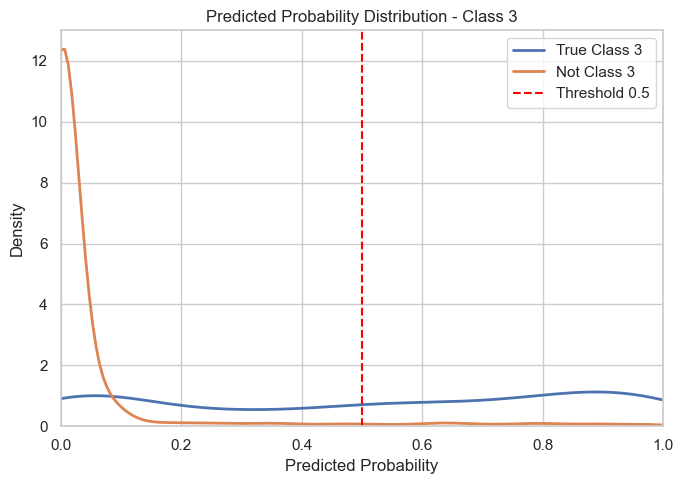

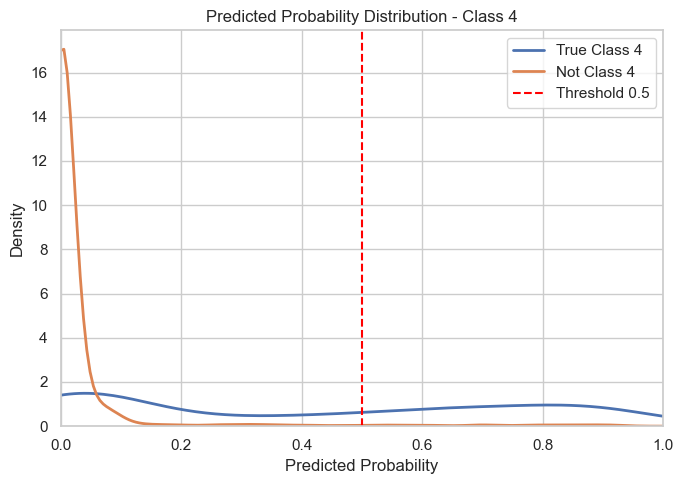

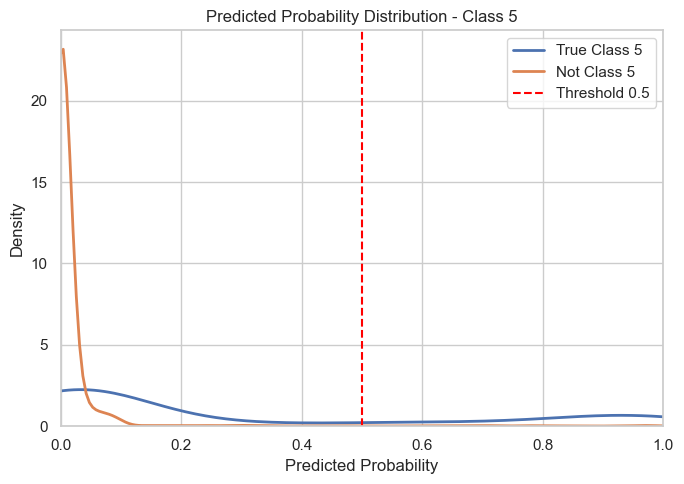

In [26]:
plot_classwise_probability_distributions(clf=best_clf, X=X_test_scaled, y=y_test, feature_names=best_features)

#### TRAIN

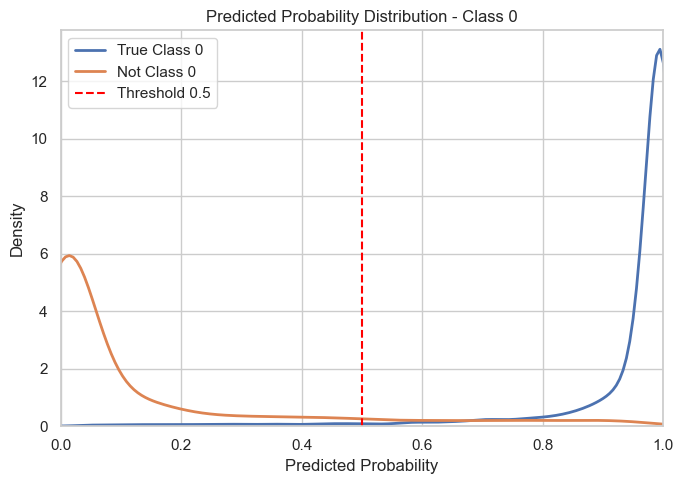

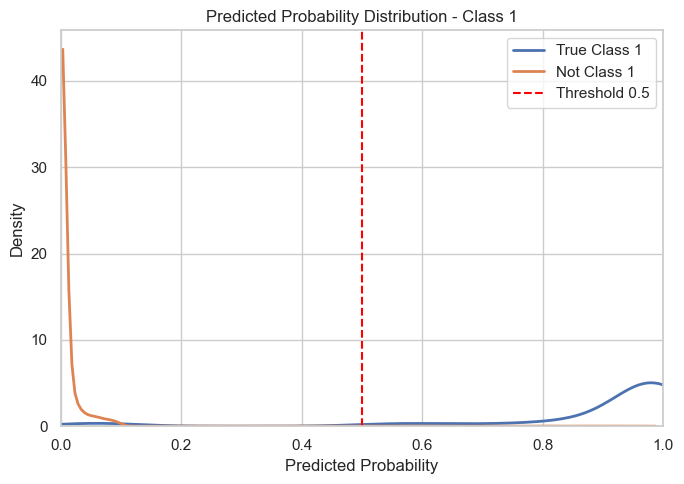

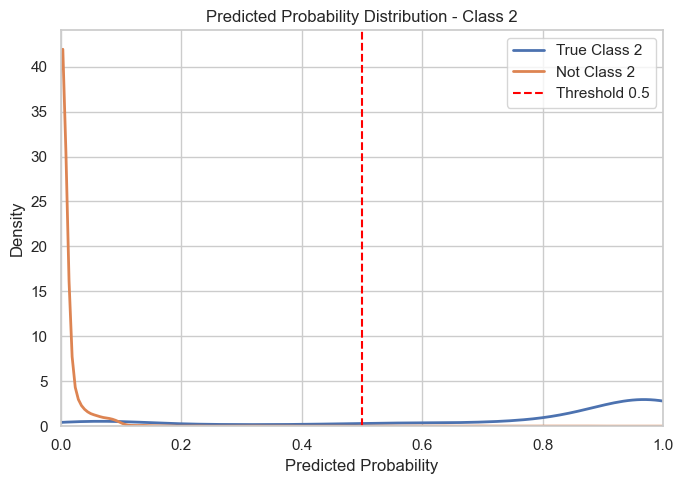

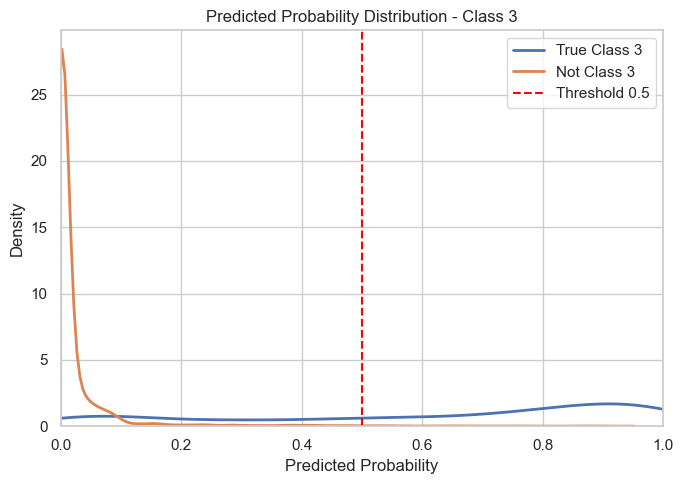

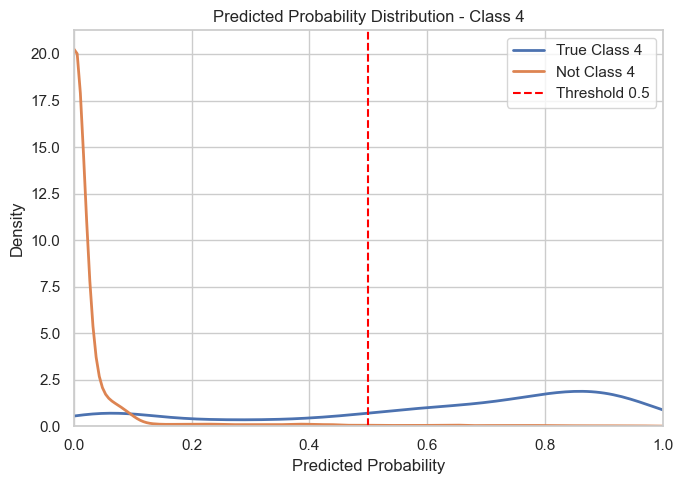

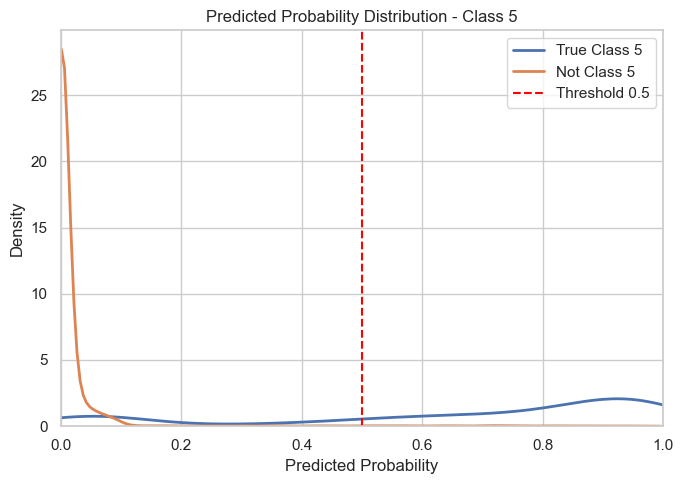

In [27]:
plot_classwise_probability_distributions(clf=best_clf, X=X_train_val, y=y_train_val, feature_names=best_features)

### Model Save and Load

In [ ]:
import joblib

joblib.dump(best_clf, 'best_clf.pkl')

In [18]:
import joblib

best_clf = joblib.load('best_clf.pkl')
best_features = ['Stiffness', 'Upstroke', 'Downstroke', 'damping_coefficient', 'mobility', 'tkeo_mean'] + ["posx",
                                                                                                           "posy"]  #define only if do not want re-run the RandomSearch

# SHAP

  0%|          | 0/656 [00:00<?, ?it/s]

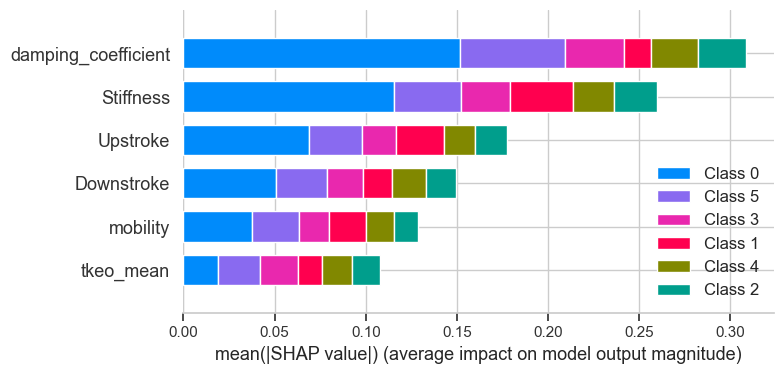

Class 0: 0.0


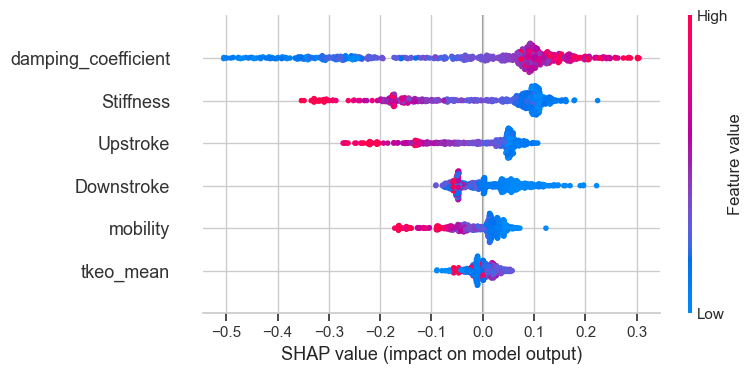

Class 1: 1.0


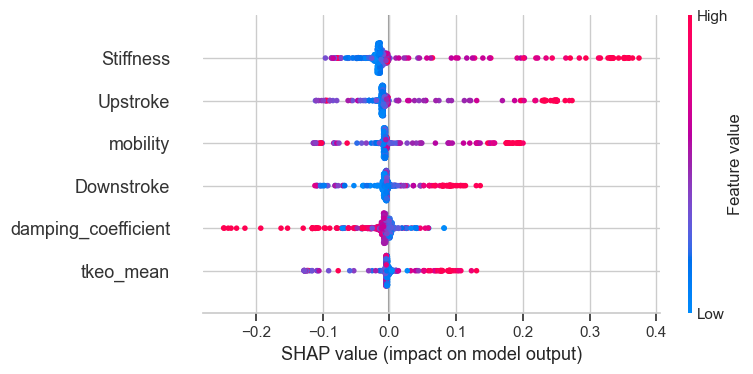

Class 2: 2.0


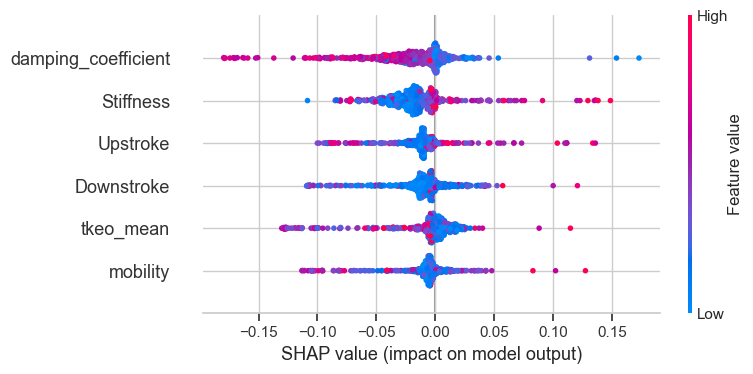

Class 3: 3.0


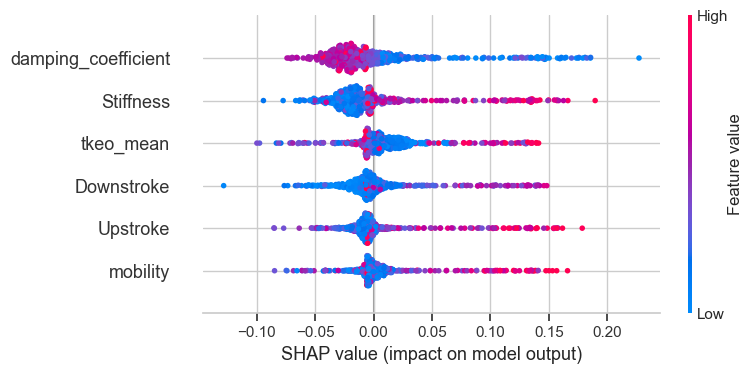

Class 4: 4.0


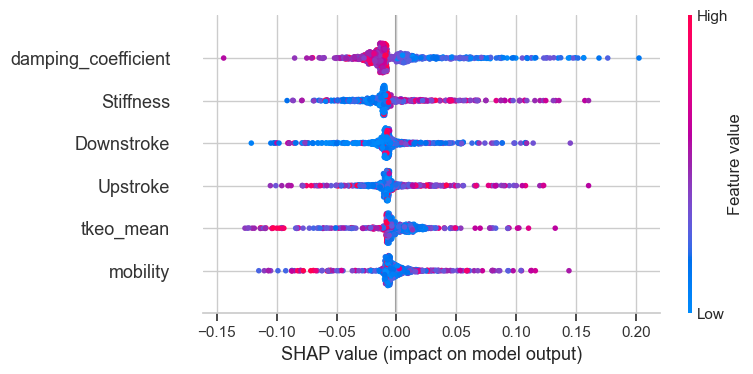

Class 5: 5.0


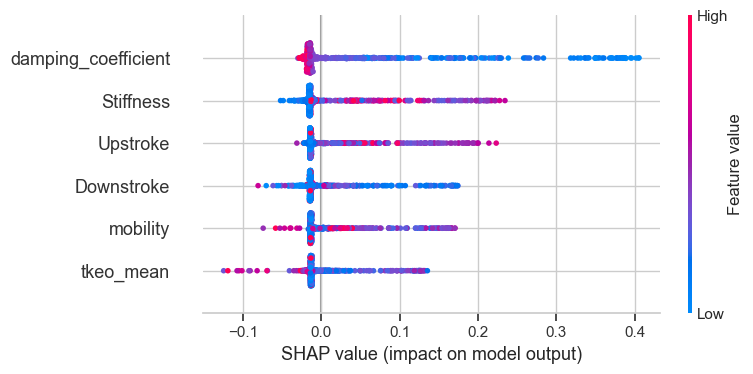

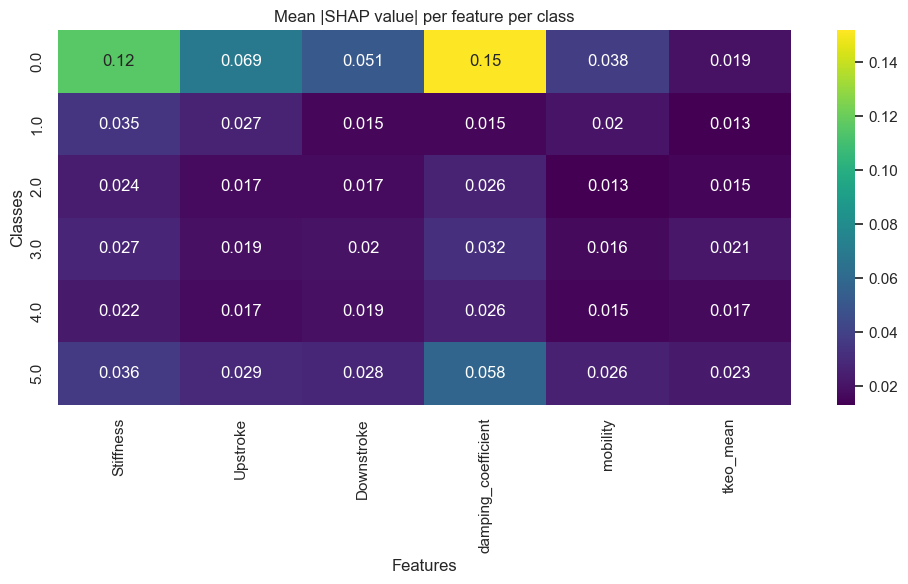

In [100]:
import numpy as np
import shap
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Features to remove in plots
features_to_exclude = ['posx', 'posy']
features_to_plot = [f for f in best_features if f not in features_to_exclude]
feature_indices_to_plot = [i for i, f in enumerate(best_features) if f not in features_to_exclude]

# Background data for KernelExplainer
bg_df = X_train_scaled[best_features].sample(frac=0.01, random_state=38)
bg_np = bg_df.to_numpy()


# Wrapped predict function
def wrapped_predict(arr):
    df = pd.DataFrame(arr, columns=best_features)
    return best_clf.predict_proba(df)


# SHAP Explainer + Sampled test data
explainer = shap.KernelExplainer(wrapped_predict, bg_np)
test_sample = X_test_scaled[best_features].sample(frac=0.1, random_state=42)
test_np = test_sample.to_numpy()

# Compute SHAP values
shap_values = explainer.shap_values(test_np)

# Convert to proper 3D format: (n_samples, n_features, n_classes)
shap_array = np.array(shap_values)
shap_values_multiclass = [shap_array[:, :, i] for i in range(shap_array.shape[2])]
class_names = best_clf.classes_

# Filter SHAP values and input for plotting
filtered_test_np = test_np[:, feature_indices_to_plot]
shap_values_filtered = [
    class_shap[:, feature_indices_to_plot]
    for class_shap in shap_values_multiclass
]

# Bar plot (overall feature importance)
shap.summary_plot(
    shap_values_filtered,
    filtered_test_np,
    feature_names=features_to_plot,
    plot_type="bar"
)

# Per-class summary plots
for i, class_name in enumerate(class_names):
    print(f"Class {i}: {class_name}")
    shap.summary_plot(
        shap_values_filtered[i],
        filtered_test_np,
        feature_names=features_to_plot,
        max_display=10
    )

# Heatmap: mean absolute SHAP per feature per class
heatmap_data = np.array([
    np.abs(shap_values_filtered[i]).mean(axis=0)
    for i in range(len(shap_values_filtered))
])

plt.figure(figsize=(10, 6))
sns.heatmap(
    heatmap_data,
    xticklabels=features_to_plot,
    yticklabels=class_names,
    annot=True,
    cmap="viridis"
)
plt.title("Mean |SHAP value| per feature per class")
plt.xlabel("Features")
plt.ylabel("Classes")
plt.tight_layout()
plt.show()